# Homework 3 Part 2

**This is a group (final project group) assignment**

In this problem, you will working with the final project's training data. Be sure to download the data files from Canvas:

1. ["data_train.npy"](https://ufl.instructure.com/files/72247539/download?download_frd=1)

2. ["t_train.npy"](https://ufl.instructure.com/files/72245951/download?download_frd=1)

**In this assignment you are allowed to use any libraries you want.**

# Computing Resources

* Use our HiPerGator cluster **"eel5840"**.
* The training data (data and labels) has been uploaded to the "share" folder. You may read directly from that folder.

# Training Data Set

The training data set is the same for every team in this course and it contains 70% randomly selected samples collected by all individuals in this course.

You should expect to receive the blind *easy test set* in the same format (numpy arrays with similar dimensions).

Let's load the training data:

In [1]:
import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

In [2]:
# Labels Integer Encoding

labels_names = ['x','square root','plus sign','negative sign',
                'equal','percent','partial','product','pi','summation']

In [8]:
# Loading Data
X_train = np.load('data_train.npy')
t_train = np.load('t_train.npy')

print(X_train.shape, t_train.shape)

(90000, 9032) (9032,)


We can see from the plot below that each class' representation in the training data is well-balanced:

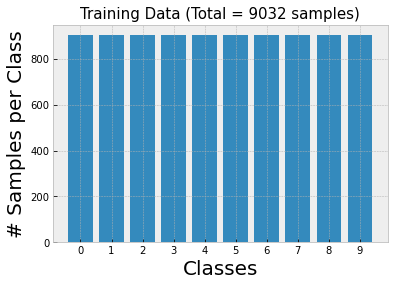

In [9]:
# Counting number samples per class
vals, counts = np.unique(t_train, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(X_train.shape[1])+' samples)',size=15);

Let's now display some examples of the training samples for each one of the 10 classes:

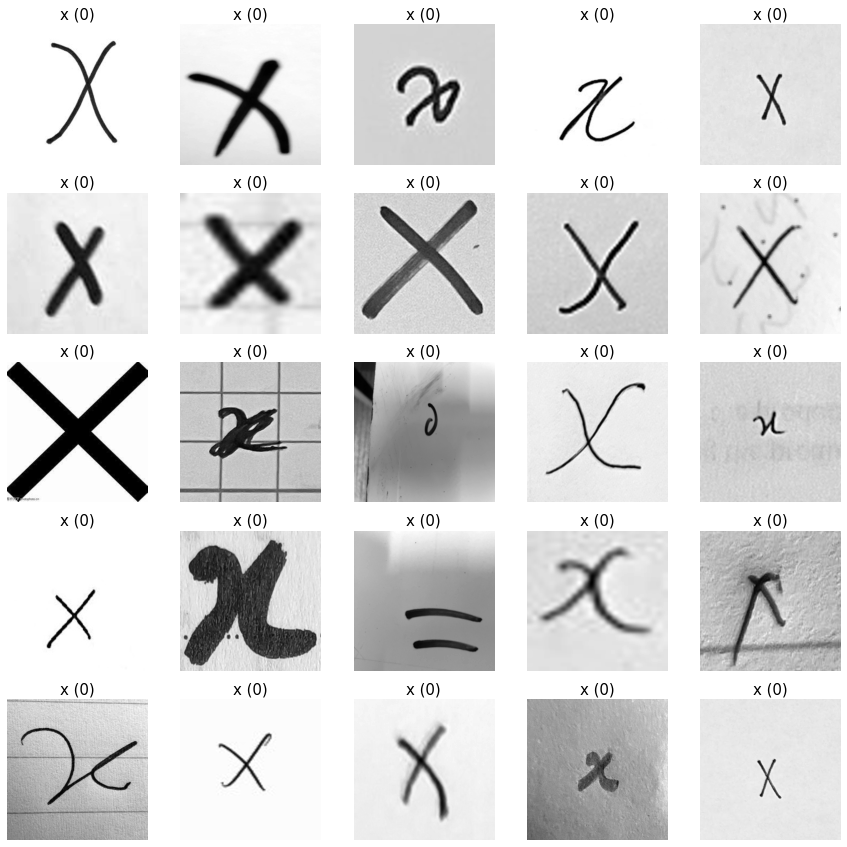

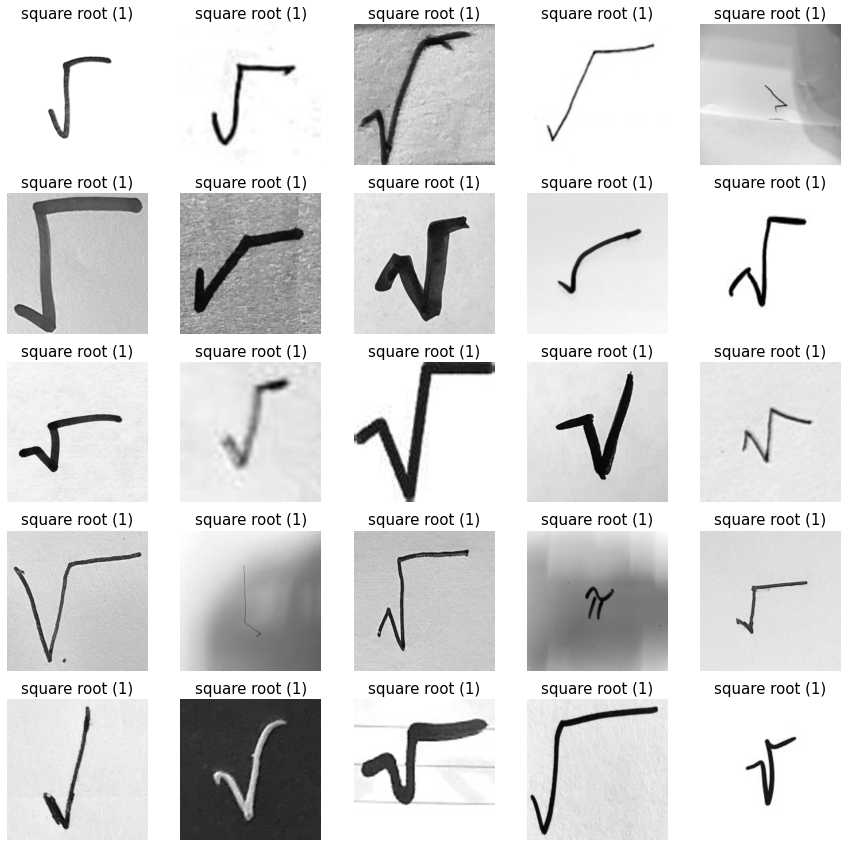

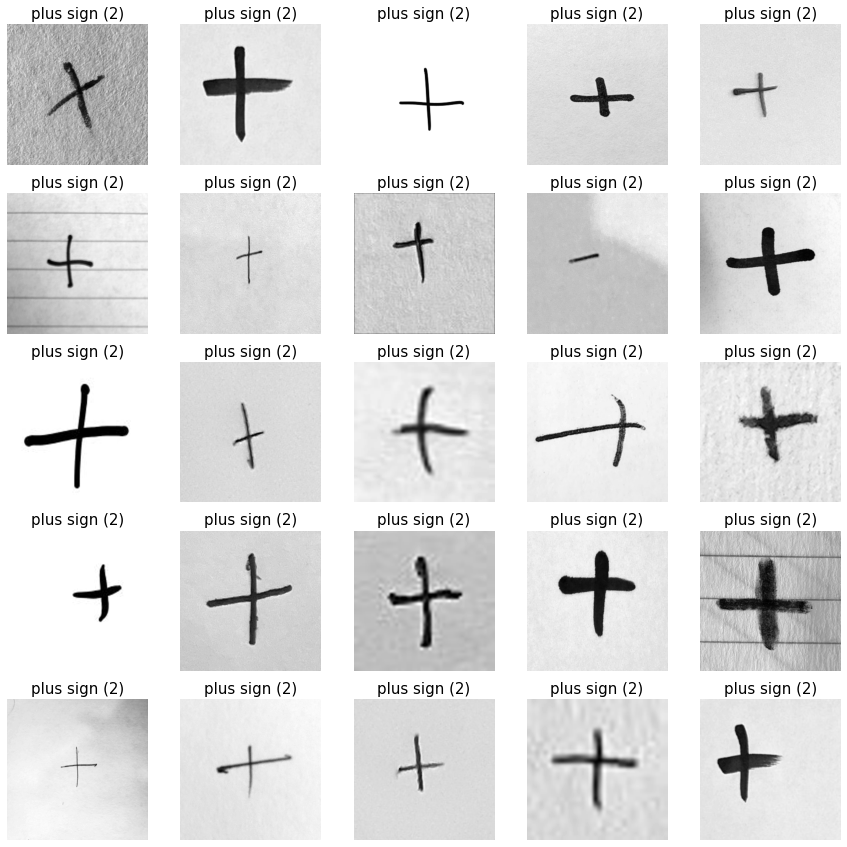

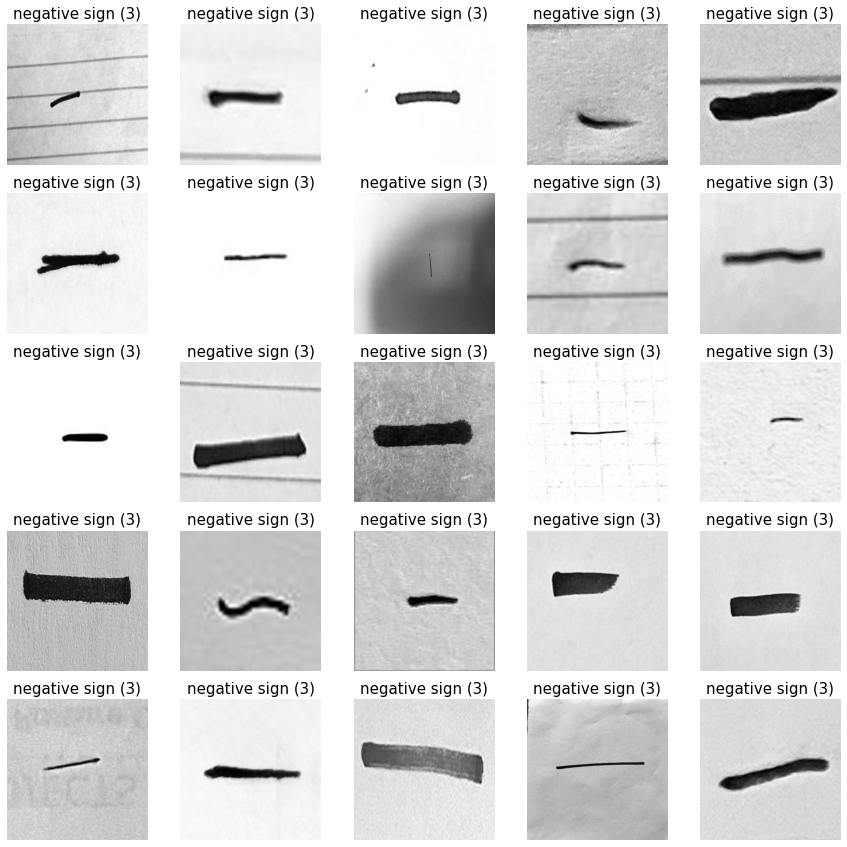

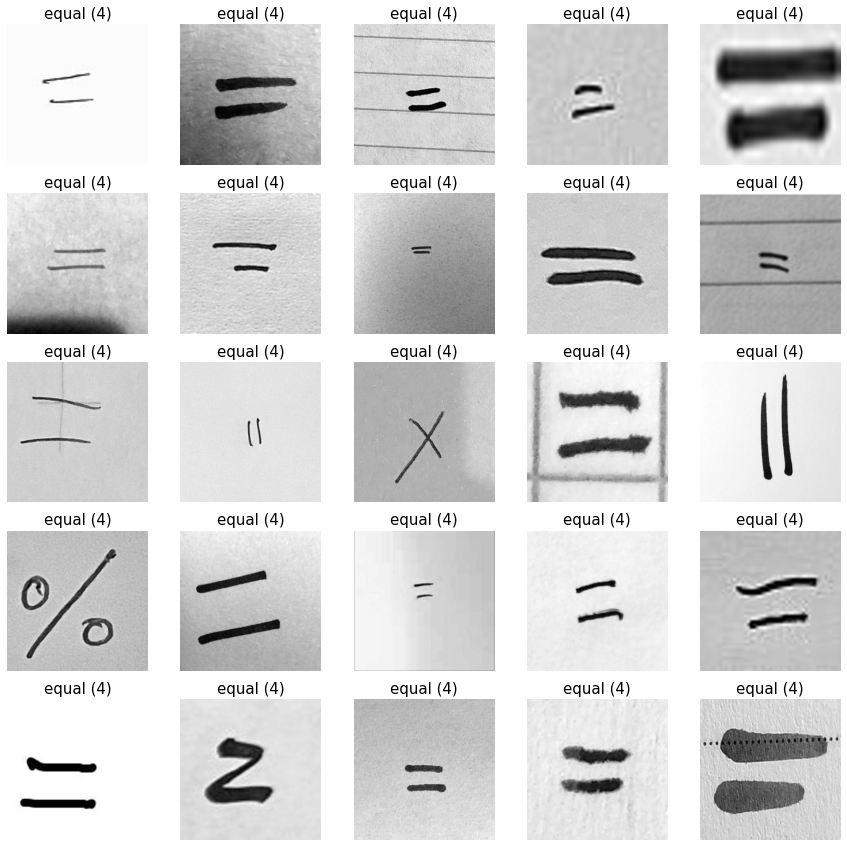

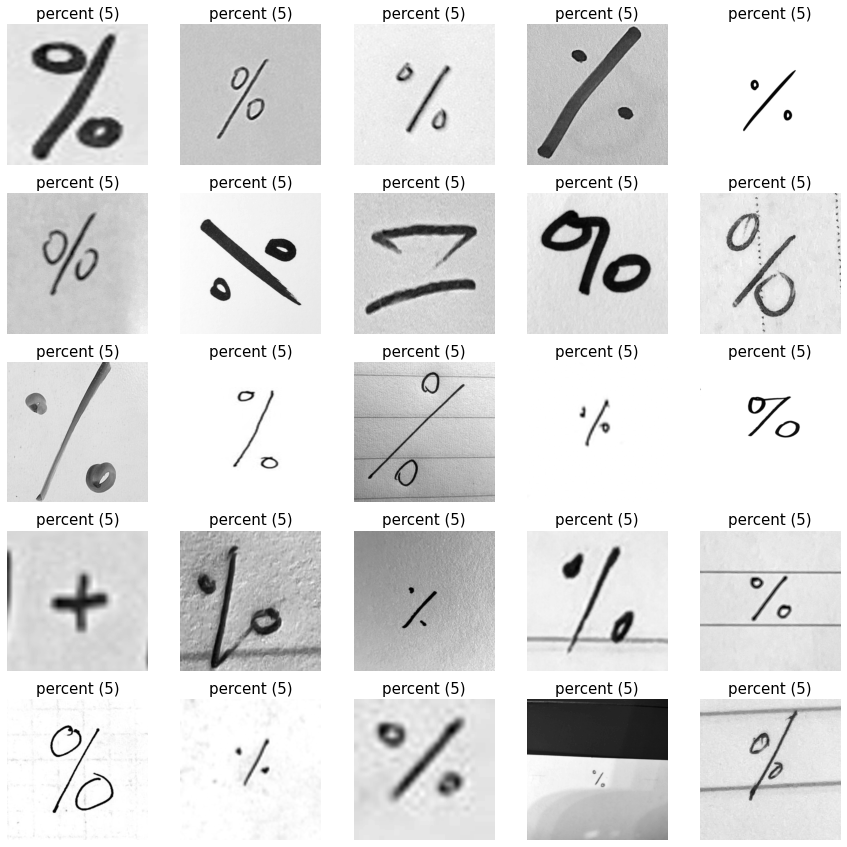

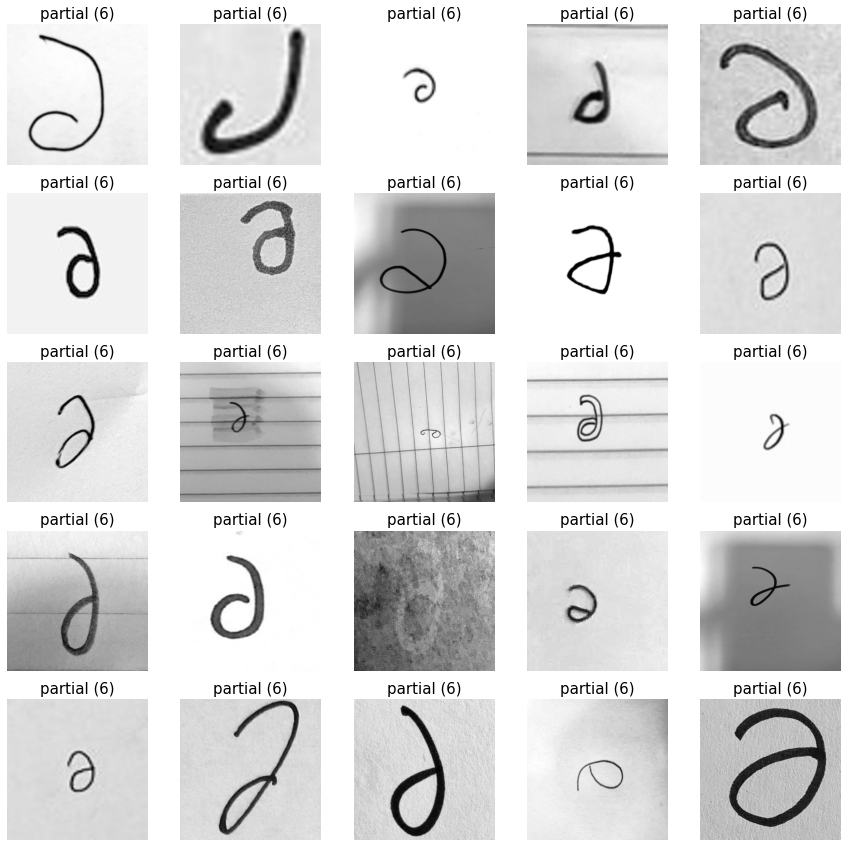

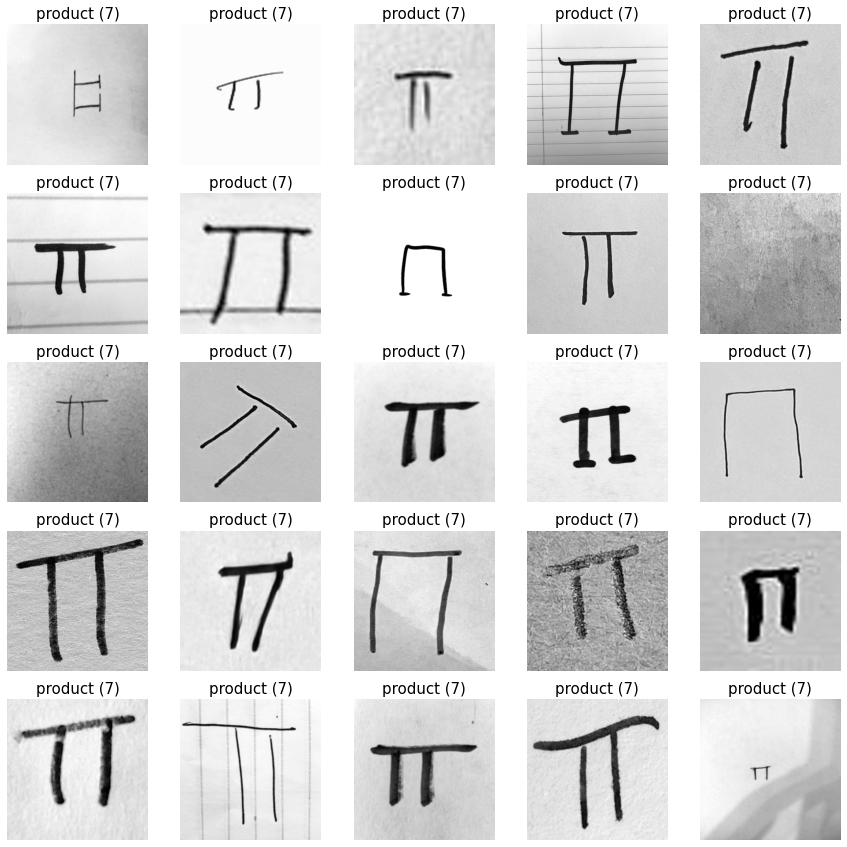

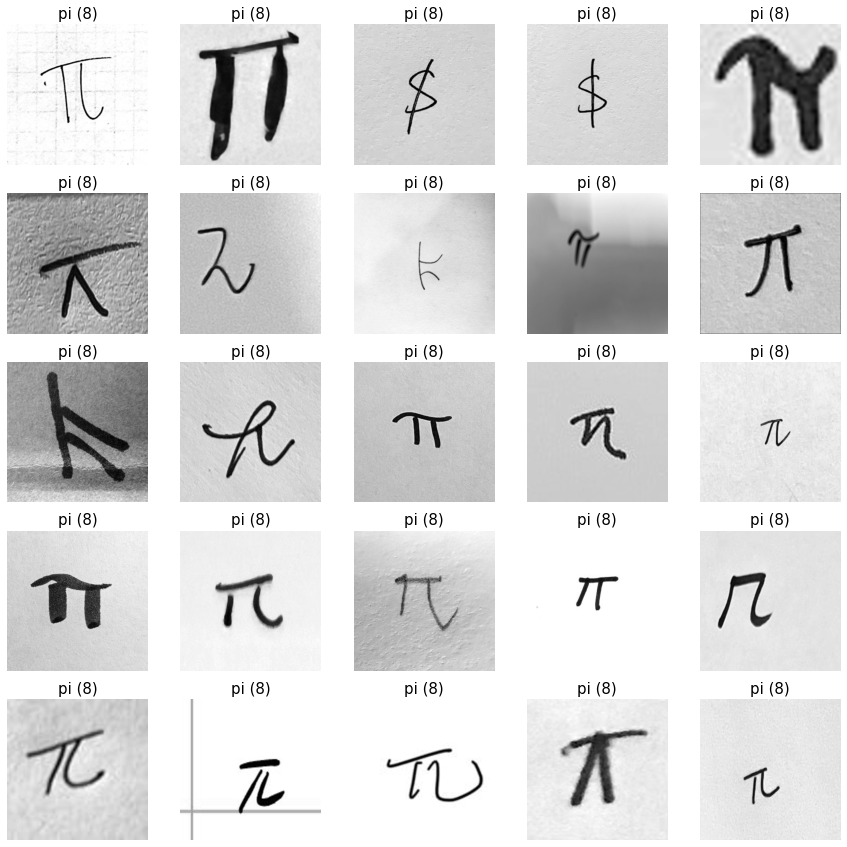

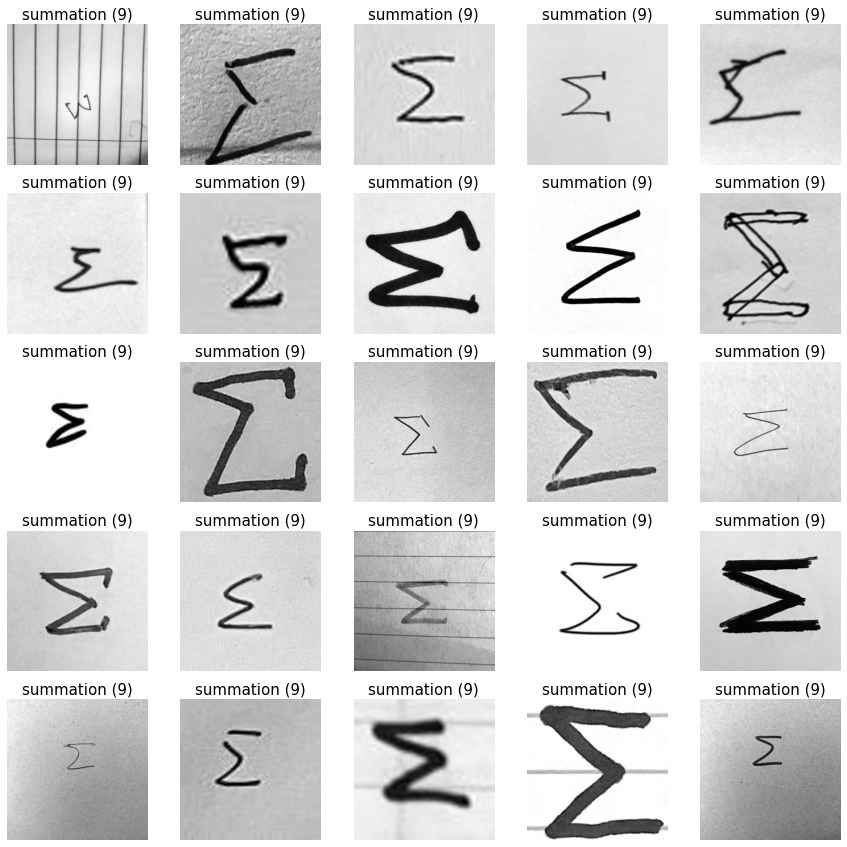

In [10]:
# Displaying some examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train[:,rnd_sample[j]].reshape((300,300)), cmap='gray')
        ll = int(t_train[rnd_sample[j]])
        plt.axis('off');plt.title(str(labels_names[ll])+' ('+str(ll)+')',size=15)
    plt.show()
    print('\n\n')

Note that you can **invert the color**:

In [11]:
X_train = 255-X_train

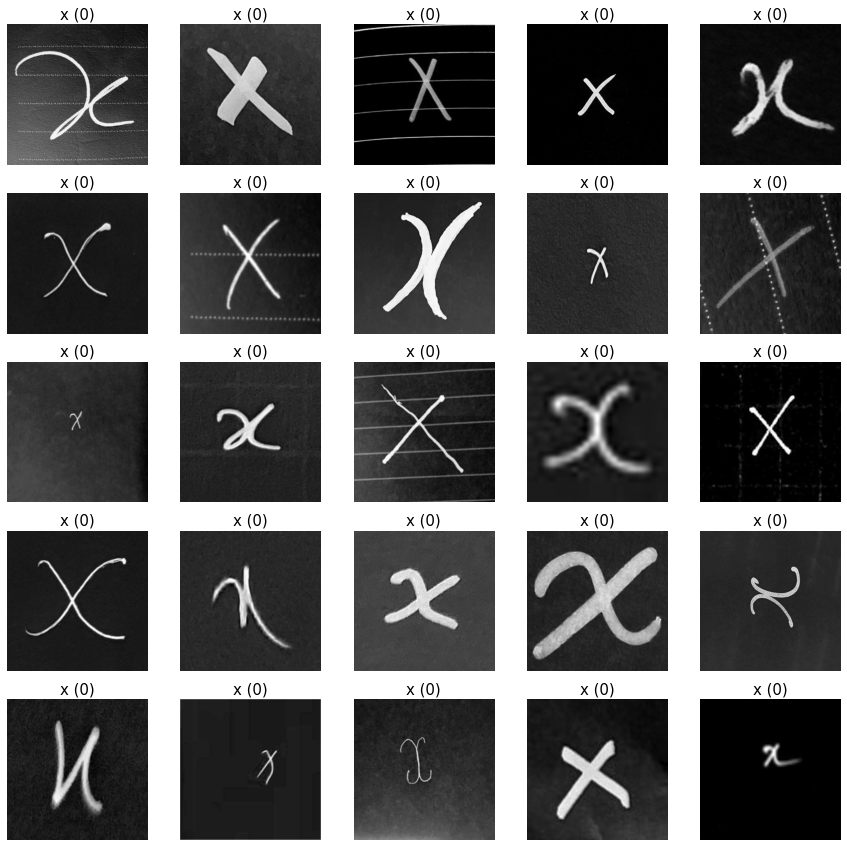

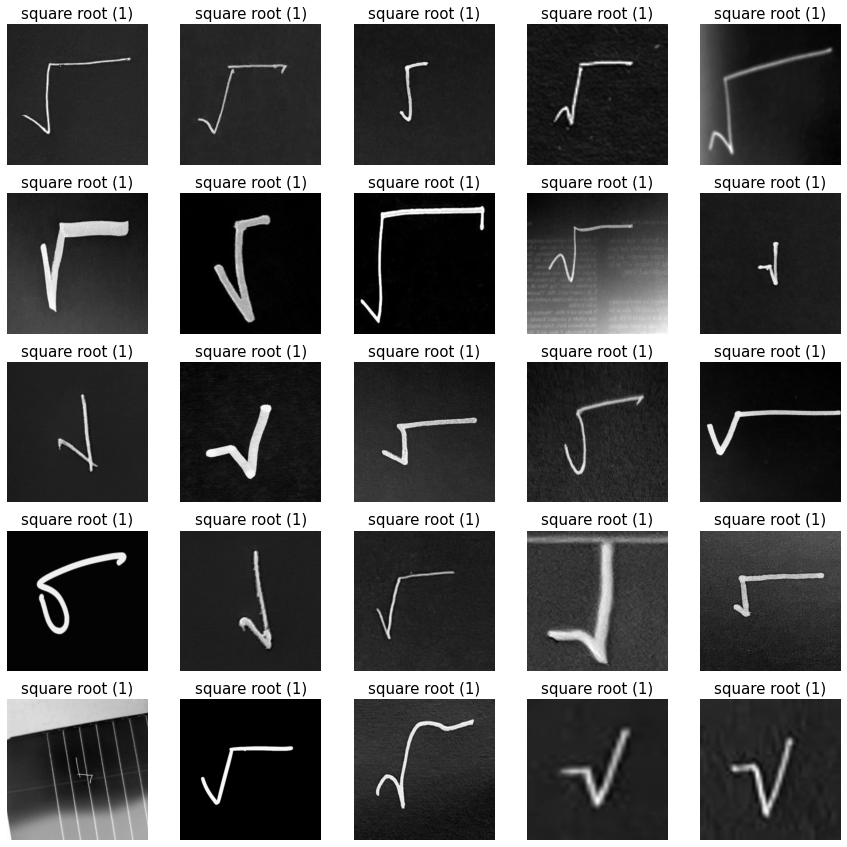

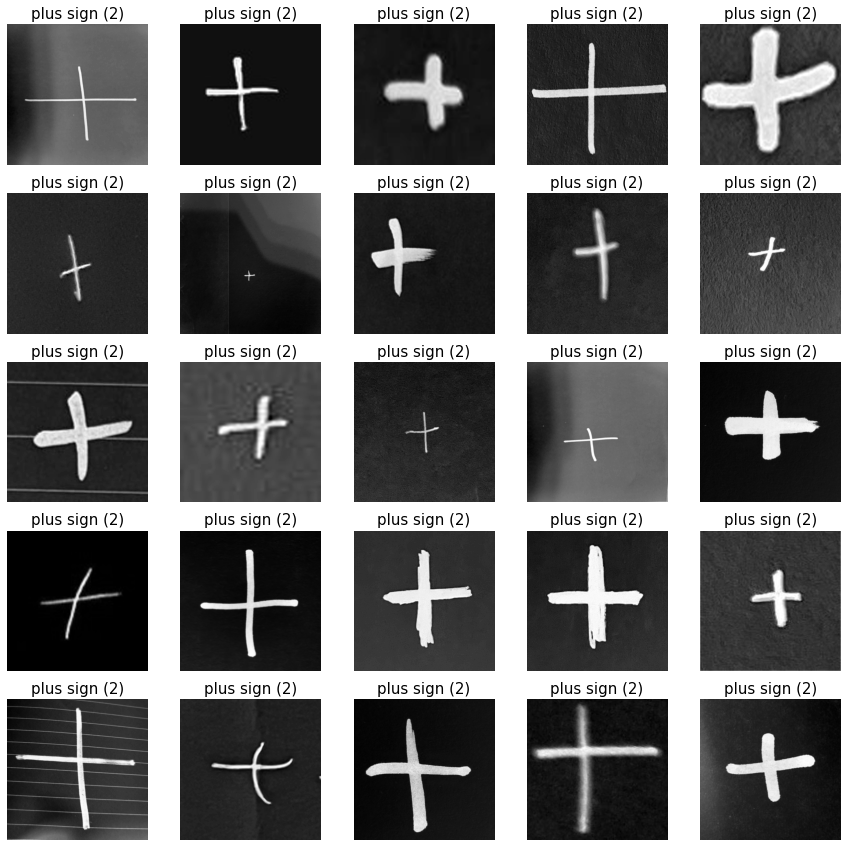

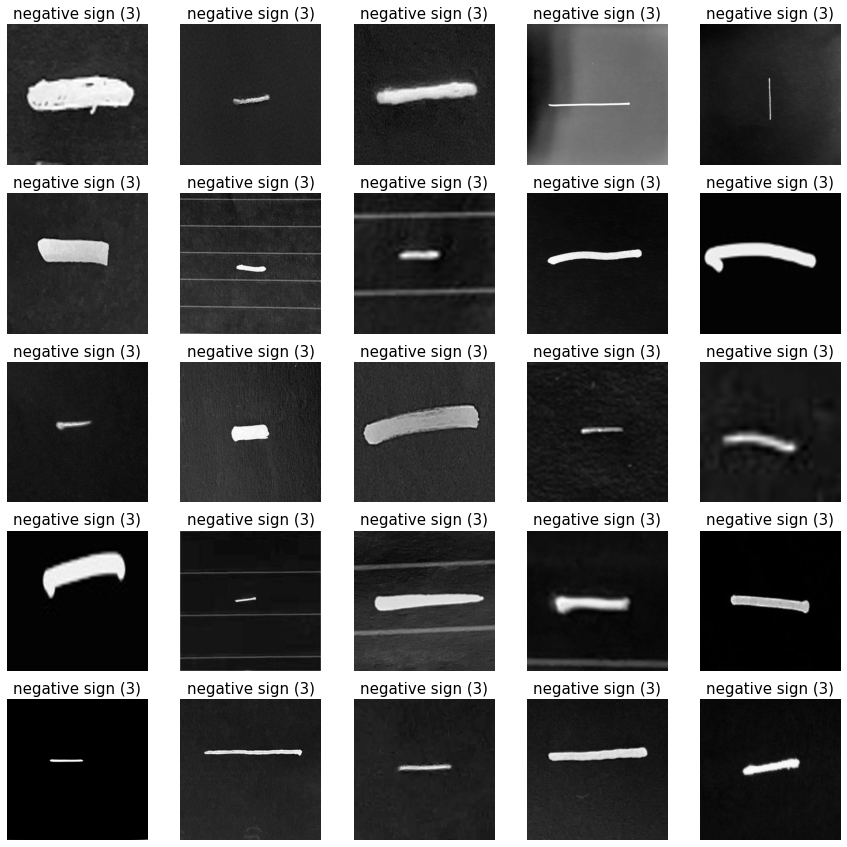

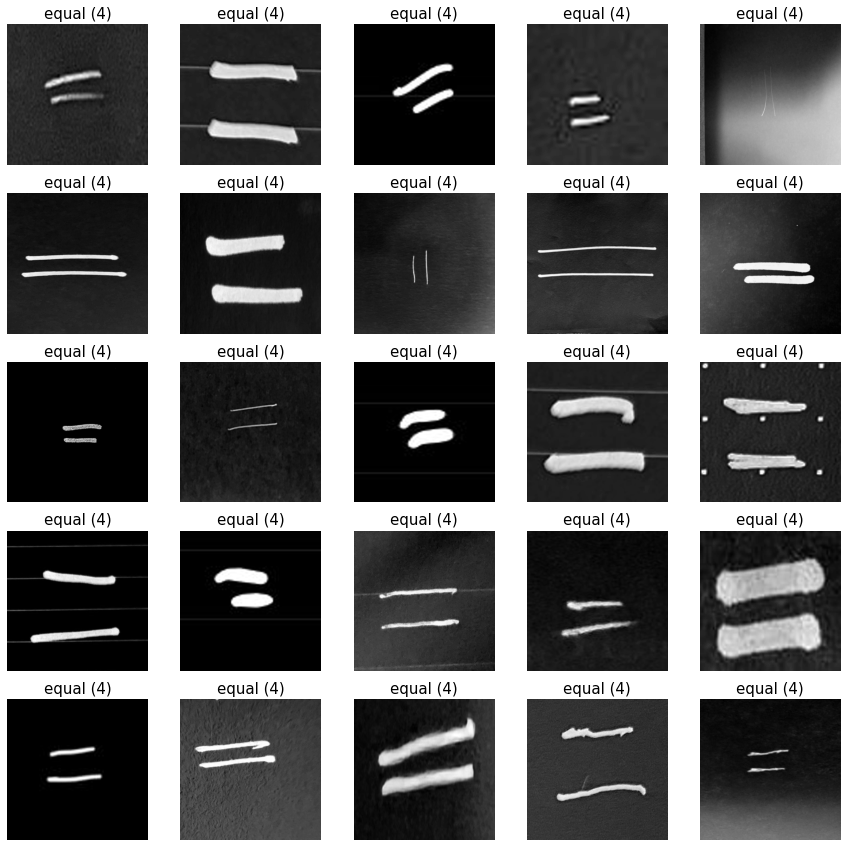

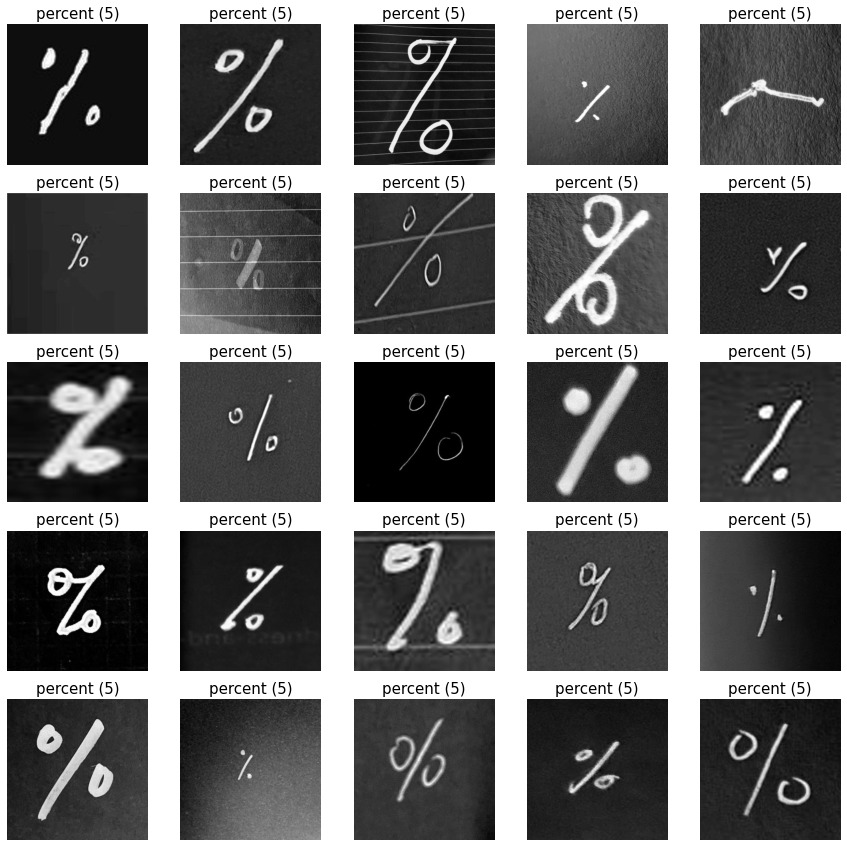

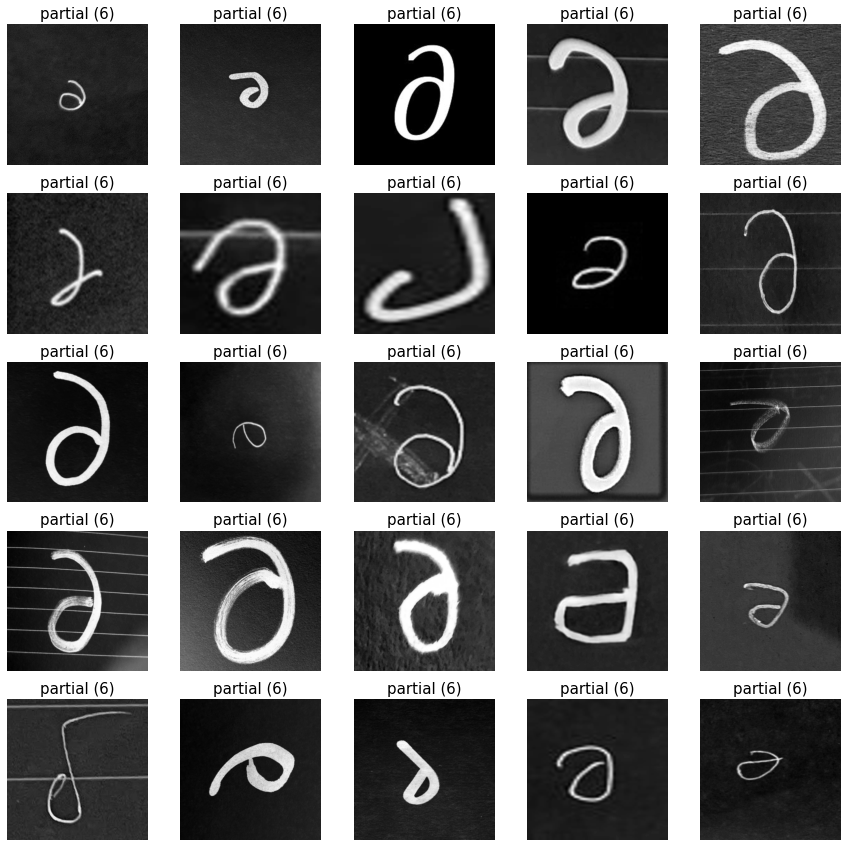

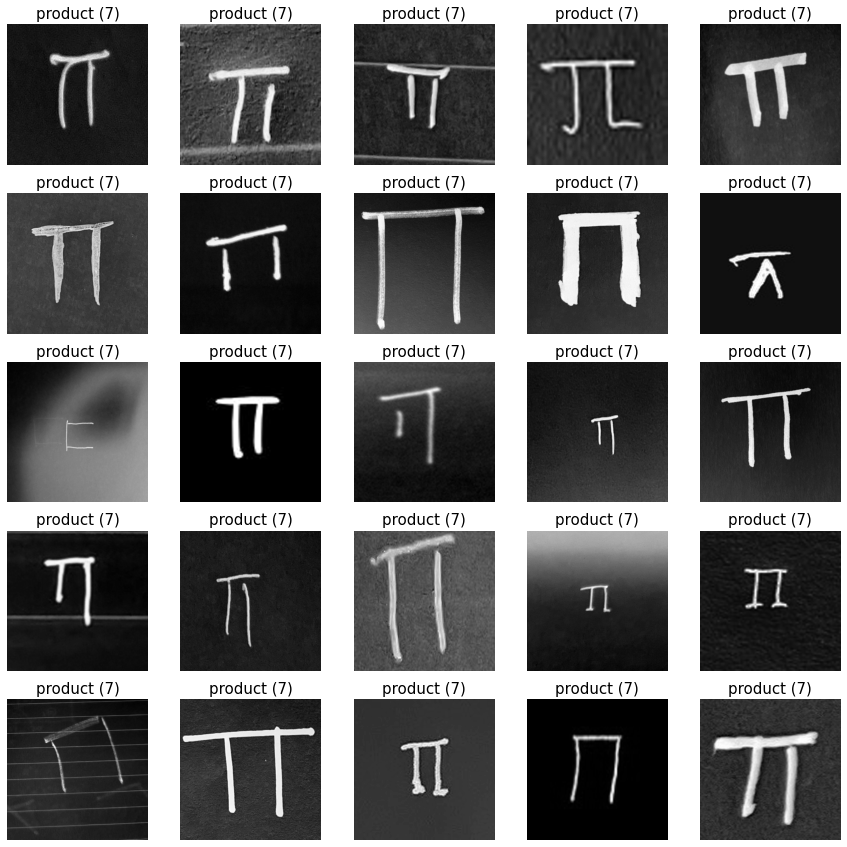

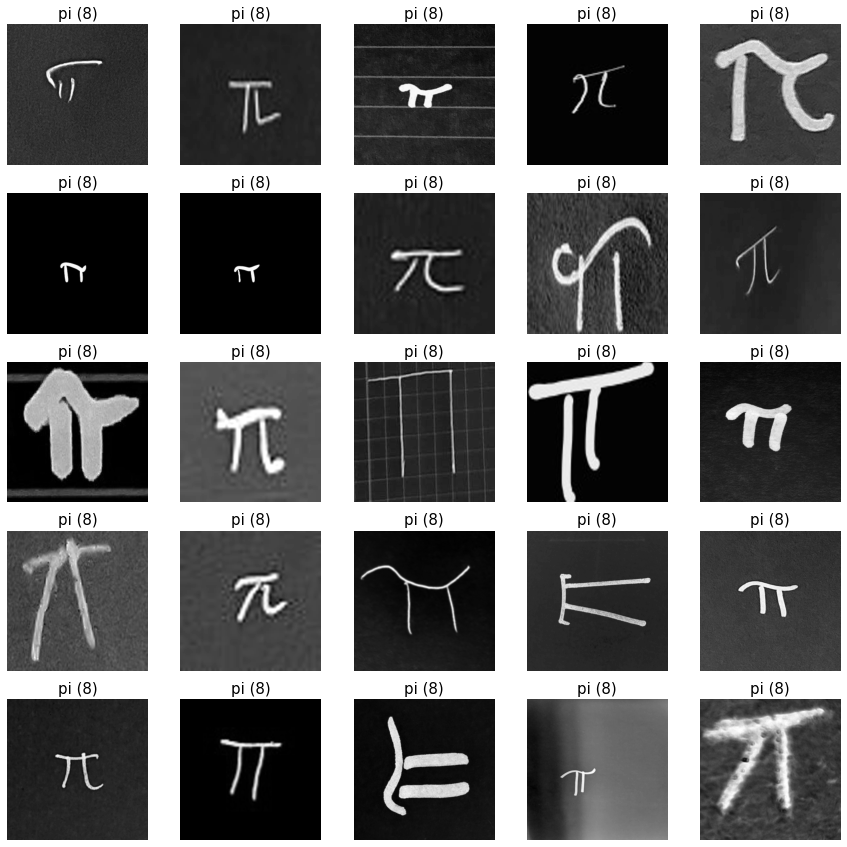

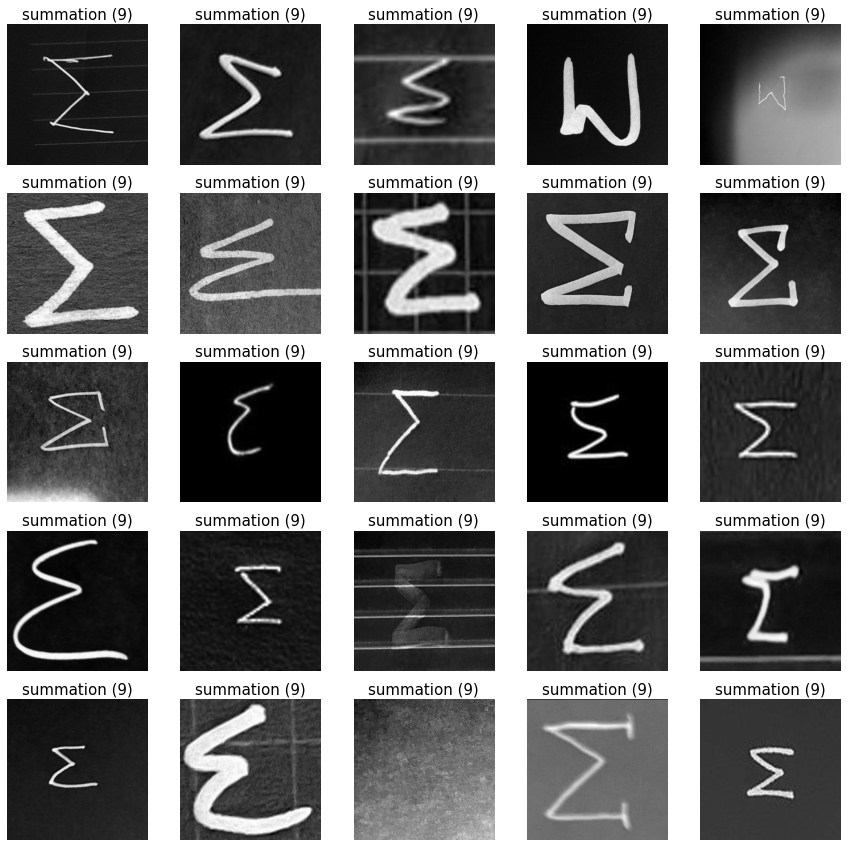

In [12]:
# Displaying some examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train[:,rnd_sample[j]].reshape((300,300)), cmap='gray')
        ll = int(t_train[rnd_sample[j]])
        plt.axis('off');plt.title(str(labels_names[ll])+' ('+str(ll)+')',size=15)
    plt.show()
    print('\n\n')

___

# Objectives

The goal of this assignment is provide a set of structured tasks to get you started on the final project for EEL5840.

By the end of this assignment, you will:

1. Define a set of ground rules to work within your group.
2. Discuss and identify challenges imposed by the data collection step.
3. Design a preliminary plan for a standard Machine Learning pipeline (data collection - feature extraction - training the model - evaluation).
5. Apply off-the-shelf libraries to train an algorithm and perform hyperparameter tuning with cross-validation.
6. Discuss your choice for the baseline model.
7. Make a concrete plan for the next steps of the project.

### Notes

This assignment does not expect algorithms to obtain accuracy scores near 90% in your validation set (in fact, it may be considerably smaller than that). 

Solutions will not be posted as this assignment is preliminary work that may be used directly towards your final project. But you will receive feedback on your work and discussions.

___

# Problem 1 (6 points)

As a group, answer the following questions:

1. Individually create **at least 4 ground rules** for working in a group. Share your answers with your team members, and together, come up with a consensus set of ground rules for working in (your) group. Submit **at least 4 ground rules** that all team members have agreed to follow when working together in the final project.

---

# Problem 2 (6.5 points)

Analyze the data by performing image visualizations and any other appropriate data processing techniques. Provide a discussion about the training dataset. Are there are classes that appear to be challenging? Are they any images that are mislabeled? Are classes balanced? Are there are pre-processing strategies would you apply prior to feature extraction?

===============================================================================================================================

### Example 

If you wish to relabel images (recommended), here's an example using visualization:

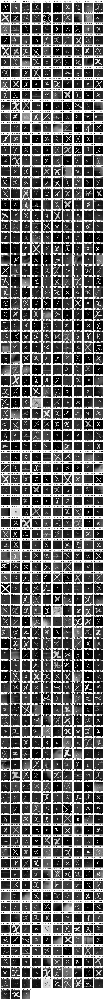

In [16]:
# Helper function for data visualization
import math

def class_visualization(label, X, t, class_names, figsize=(15,150)):

    # Index locations where class label stored in X_train
    sample_idx = np.where(t==label)[0]

    #Number of samples in class label
    N = len(sample_idx)

    # settings for grid plot
    grid_rows = math.ceil(N/10)
    grid_columns = 10

    # Plotting all images
    plt.figure(figsize=figsize)
    for i in range(N):
        plt.subplot(grid_rows, grid_columns, i+1)
        plt.imshow(X[:,sample_idx[i]].reshape(300,300), cmap='gray')
        plt.axis('off')
        plt.title(class_names[label]+'('+str(label)+'): '+str(sample_idx[i]));
        
class_visualization(0, X_train, t_train, labels_names)

If there are any images that appear small and I can't distinguish, I'll plot them individually for better inspection:

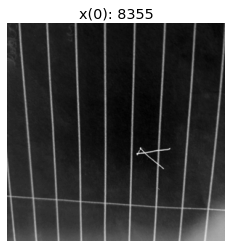

In [25]:
idx = 8355
plt.imshow(X_train[:,idx].reshape(300,300), cmap='gray')
plt.axis('off')
plt.title(labels_names[0]+'(0): '+str(idx));

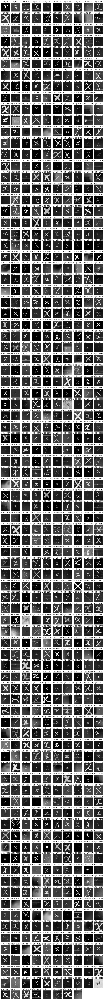

In [28]:
# Images identified as misclassified by visualization

idx_to_correct = np.array([495, 2099, 2862, 2976, 3357, 3575, 3628, 3838, 4186, 4631, 4752, 4892, 5030, 5889, 6109, 6736, 7418, 
                          7512, 7602, 7604, 7662, 7716, 8157, 8438, 8556, 8652])
labels_correct = np.array([  1,   8,    1,    8,    6,    8,   -1,    1,    4,    4,    2,   -1,    1,   -1,    1,    1,   -1, 
                            -1,    3,    6,    1,   -1,    1,    5,    3,   -1])

# Update labels for class label
t_train[idx_to_correct] = labels_correct

# Visualize data to make sure
class_visualization(0, X_train, t_train, labels_names)

Once you fix all mislabeled samples, you can save the updated file:

In [ ]:
# np.save('t_train_corrected.npy', t_train)

=========================================================================================================

---

# Problem 3 (35 points)

Design and train at least 3 classifiers on the training data (examples include: KNN, SVM, Naive Bayes, FLDA, etc.). **You can work with the data as is, or you may transform the data in any way you see fit** (gray-color, PCA features or any other feature extraction technique, morphological preprocessing, etc.).

You are allowed to use *any* libraries, this includes ```scikit-learn```, ```tensorflow``` or ```pytorch```.

In your implementation, you should follow the standard procedures:
1. Preprocess the data, this includes feature scaling.
2. Split data into training and test sets. Make sure you use the same training set in all classifiers (recommendation: fix ```random_state``` in [```train_test_split```](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html) function).
3. Perform $k$-fold cross-validation to determine the best set of parameters for each classifier. Consider using the [```GridSearchCV```](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html) or [```RandomizedSearchCV```](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html) approach for experimental design. See an example in Lecture 21.
4. Report performance results in both training and test sets.
5. Include a paragraph that compares the performance of all classifiers, and steps you will take to improve upon these preliminary results.

All classifiers should be compared in terms of their performance, using the following evaluation metrics:
1. Overall accuracy, and
2. Confusion matrices

Note: You may include a paragraph description about your experience in using the HiPerGator. If you encounter any issues, please describe them.

---

## Submit your Solution

Confirm that you've successfully completed the assignment.

Along with the Notebook, include a PDF of the notebook with your solutions.

```add``` and ```commit``` the final version of your work, and ```push``` your code to your GitHub repository.

Submit the URL of your GitHub Repository as your assignment submission on Canvas. 

---